Pictures were taken from here

https://github.com/Dyakonov/DL/blob/master/2020/DL2020_055selfSV_20n.pdf

# Self-Supervised Learning (SSL)


# Supervised/Semisupervised/Unsupervised/Self-Supervised

Main idea: train model on different unsupervised task. Then fine-tune result model to solve our current task (transfer learning)

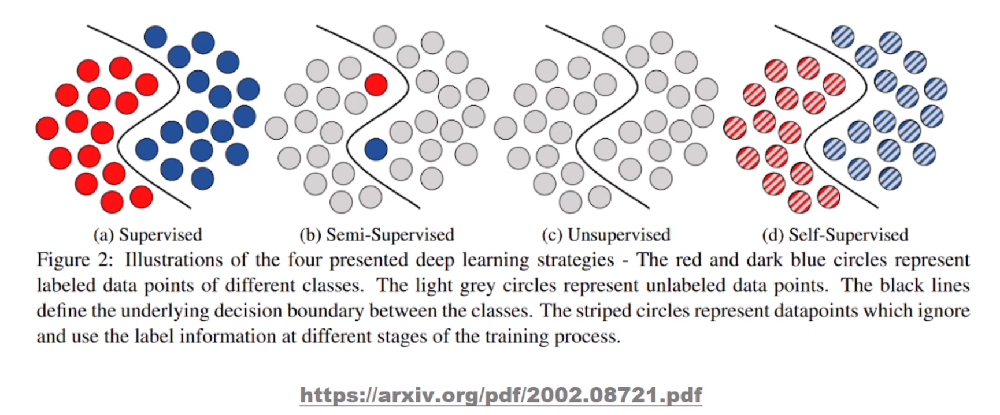

# Self-supervised vs transfer learning

In **transfer learning**, a model is pre-trained on a large dataset to perform some predictive task from source domain and then fined to perform another task from target domain. E.g. in the source domain we pre-train the model for object recognition of vehicles and then fine tune in the target domain to recognize the brand of cars.

**Semi-supervised learning** does the same thing. But the difference between both is how the models are pre-trained. In transfer-learning, model is pre-trained through supervised learning in which dataset from source is annotated by humans while in self-supervised learning, model is pre-trained unsupervised without labelled data. Unsupervised learning is carried out by performing some auxiliary tasks set by humans. Best example is the BERT model which performs auxiliary tasks like predict the present word from past words or predict present word from future words or predict word from both present and past words in a given sentence. Data is not labelled rather BERT generates labels.

# SSL = pretext + downstream tasks

Pretext task is not our task but it lets to create a good object representation, labels are created automatically.

Downstream task - solving of our task using object representations that were trained in pretext task. Can be fulfilled by simple model or fine-tuned model from pretext task.

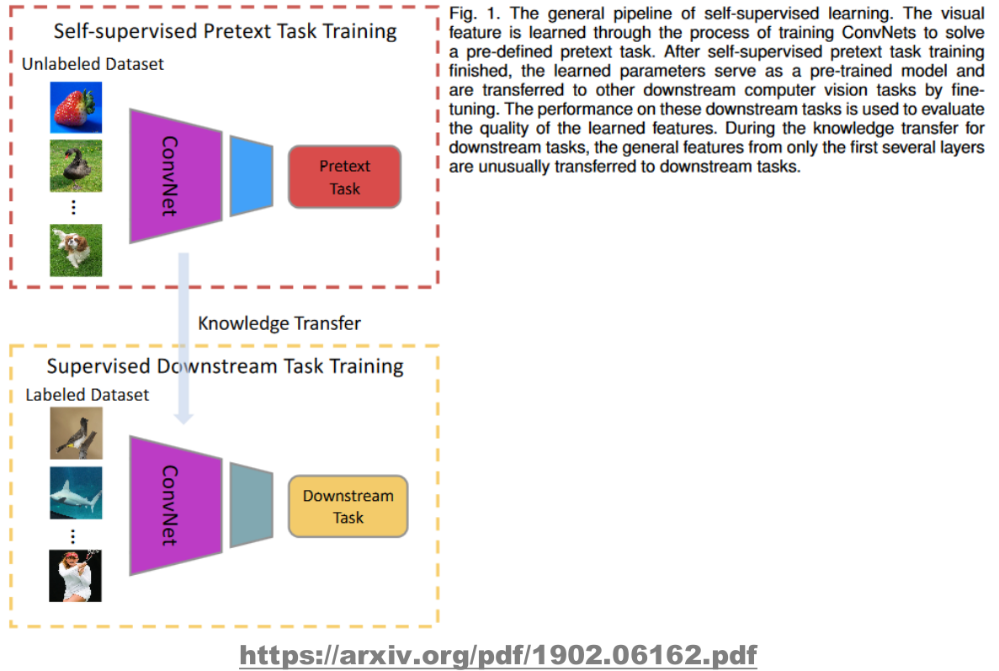

# Why use it?

- we don't have labels at all
- hand labeled data are expensive
- there are too much of unlabeled data and not so much of labeled data
- corresponds with real human training

Motivation:
- features obtained from pretext task can be useful for many other tasks
- good data representation
- pre-training

# SSL task types

# Predicting (spatial) context / Relative position

Model takes couple of patches and must predict the next patch or must classify which configuration was sampled.

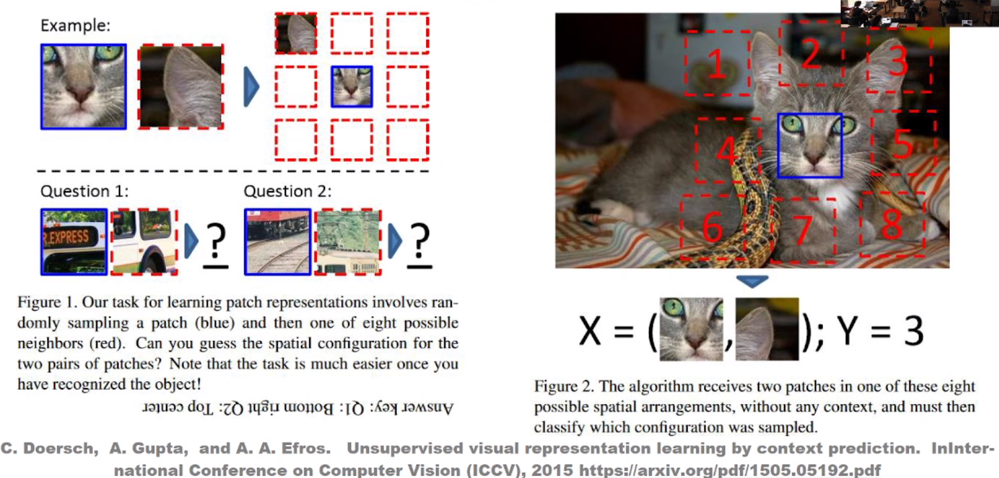

First patch is selected randomly, second second is selected nearby of the first, there are gaps between patches to prevent predicting by common borders of adjacent patches.

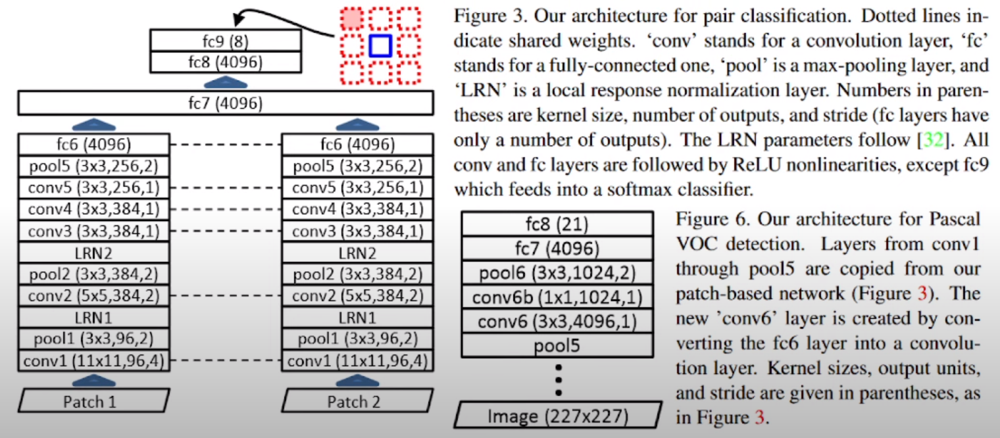

Two color channels of image are filled by noise. This is made because NN can easily find out position of patch by analyzing chromatic abberation of each color channel.

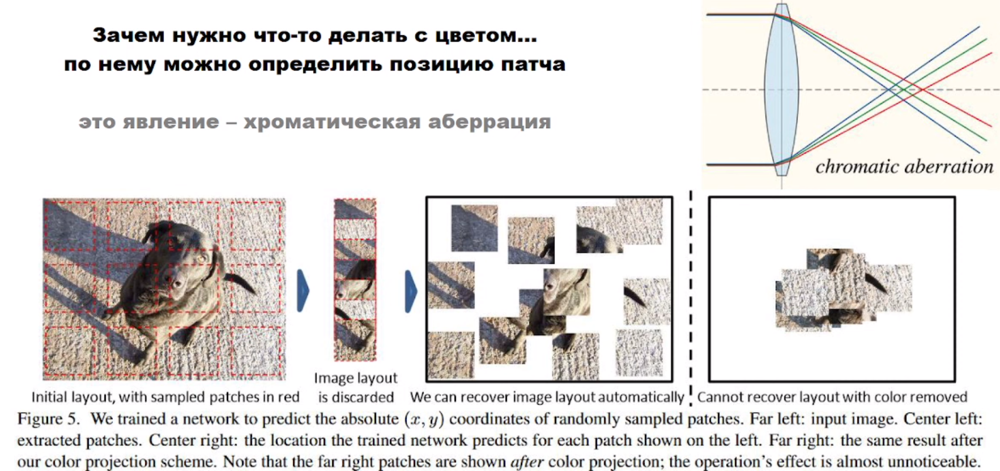

# Predictin image rotation

Main idea: rotate image and train model to predict if it's rotated and if it is - how it's rotated (90, 180 or 270 degrees). 

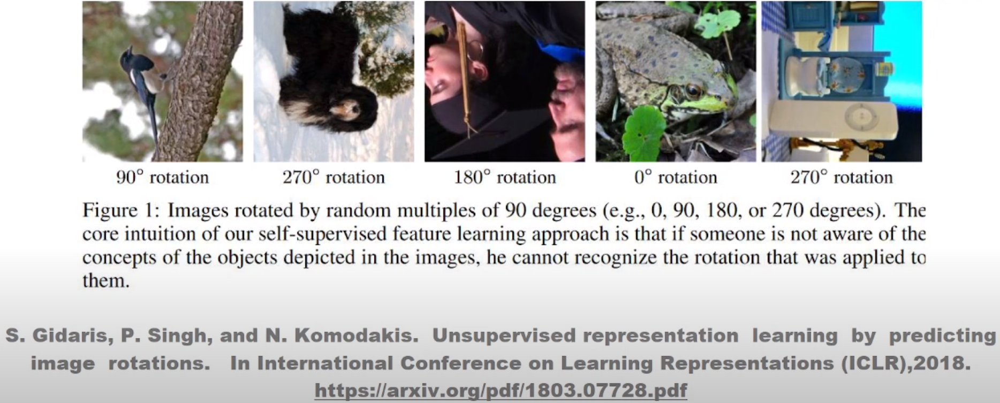

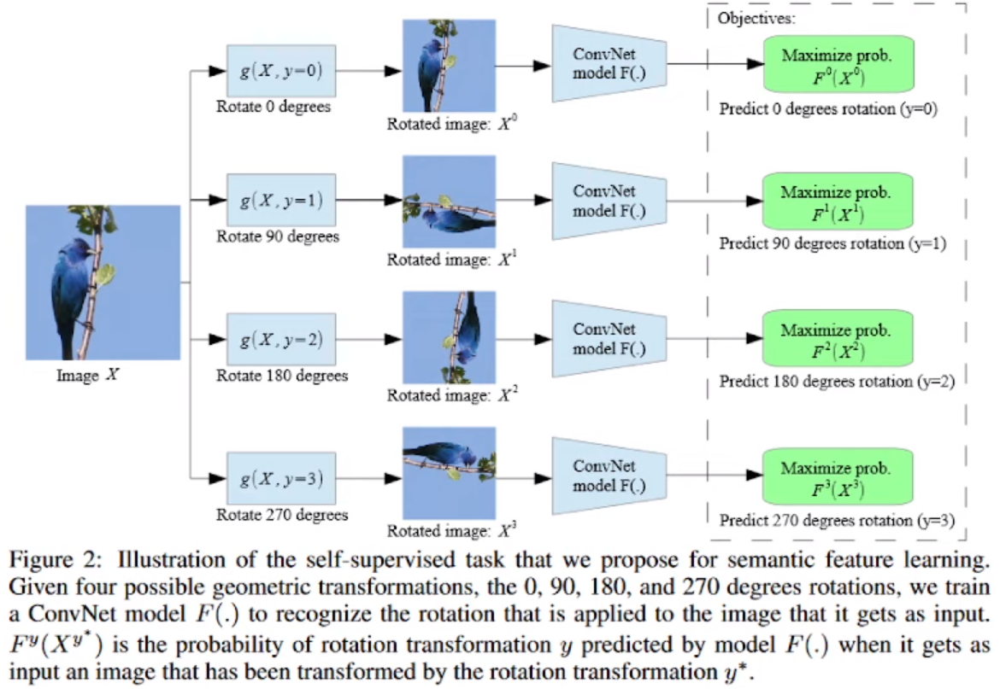

Supervised models have better accuracy on huge datasets, but when number of training examples is lesser than 1000 - semi-supervised models win.

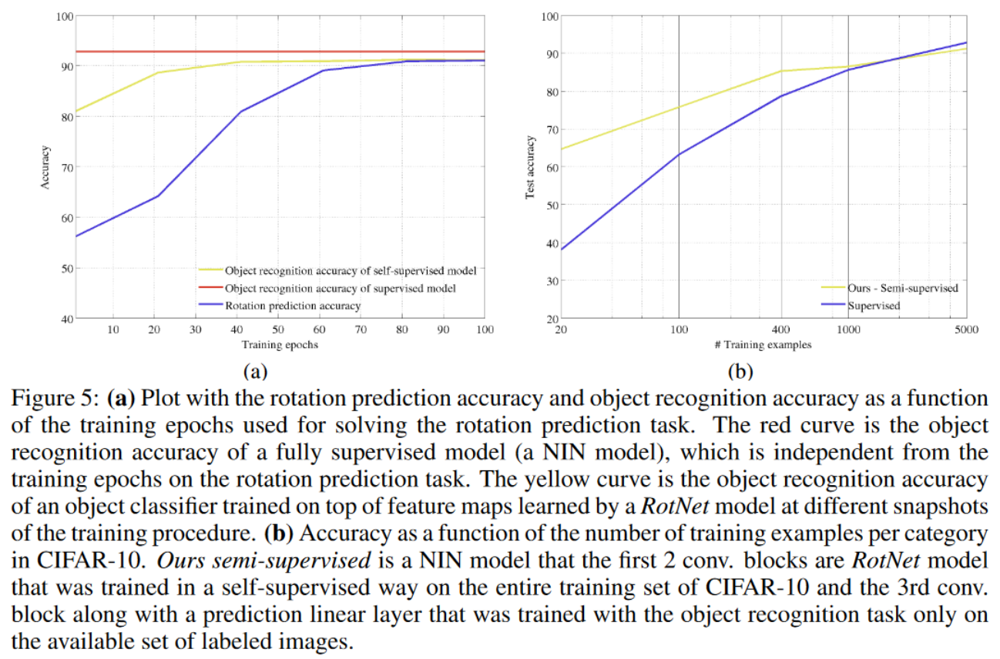

Further idea evolution is to predict rotation and class.

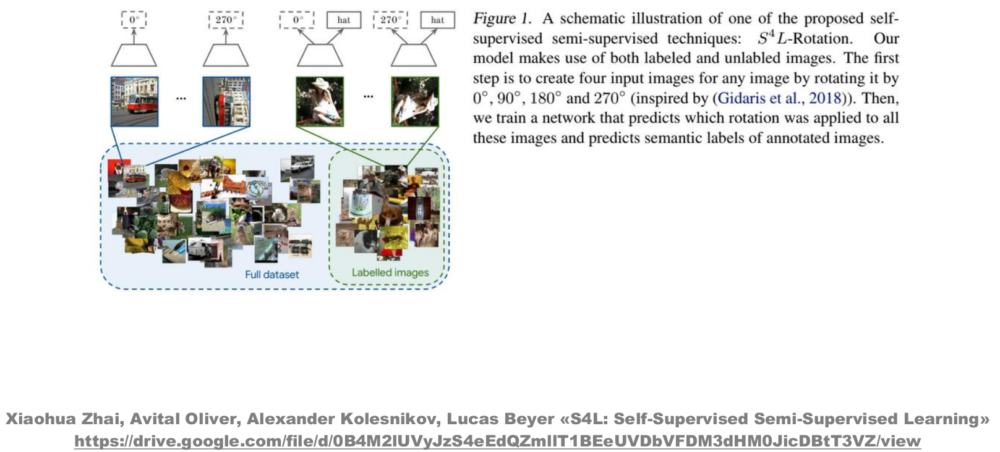

# Exemplar

Main idea: select interesting part of image and use augmentations (translation, scaling, rotation, constrast, color, etc.). Then solve classification task where class - number of reference image. So, model must understand that these images are the same despite different transformations.

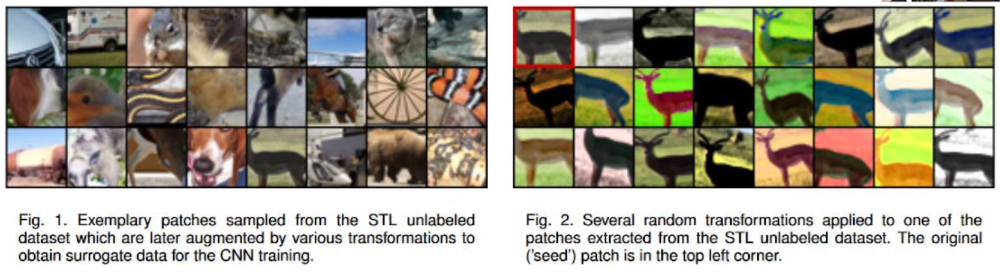

# Jigsaw

Main idea: learn image representation by solving jigsaw puzzle.

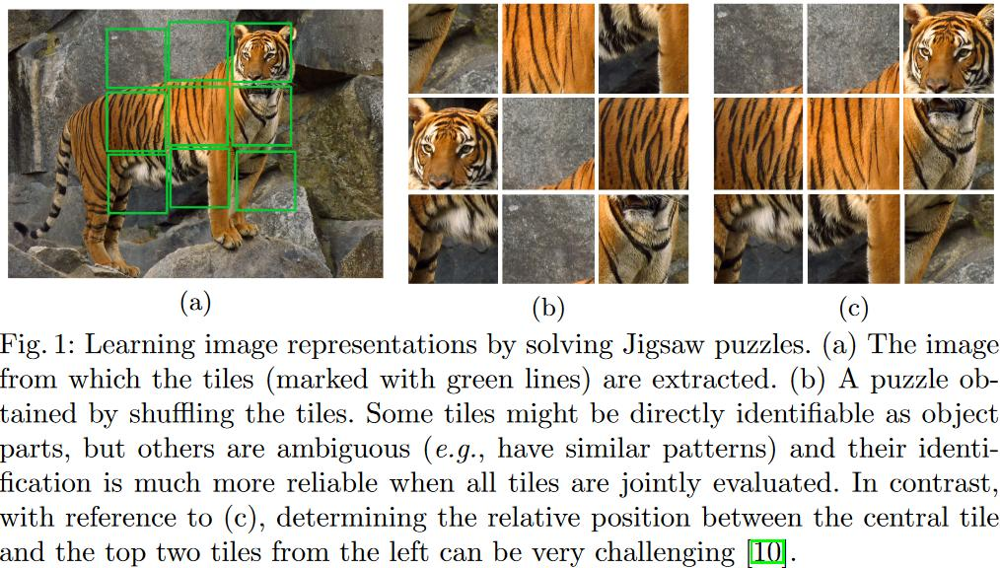

Divide window 225x255 into 9 parts, use one of predifined permutation. Task - find the number of permutation.

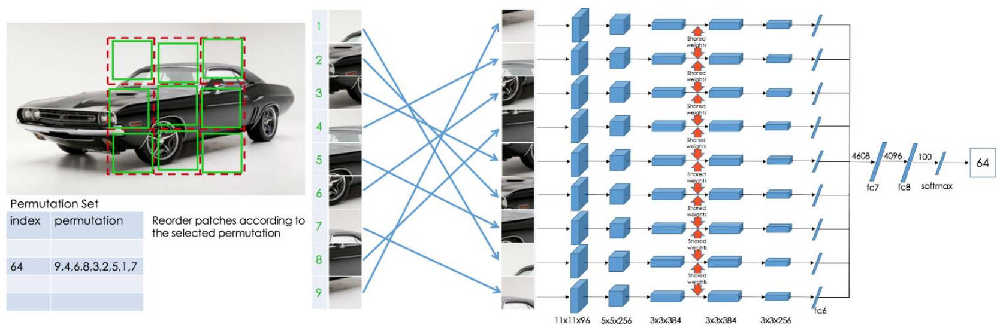

## Jigsaw ++

Main idea: replace some parts of jigsaw with parts from different images and try to solve it.

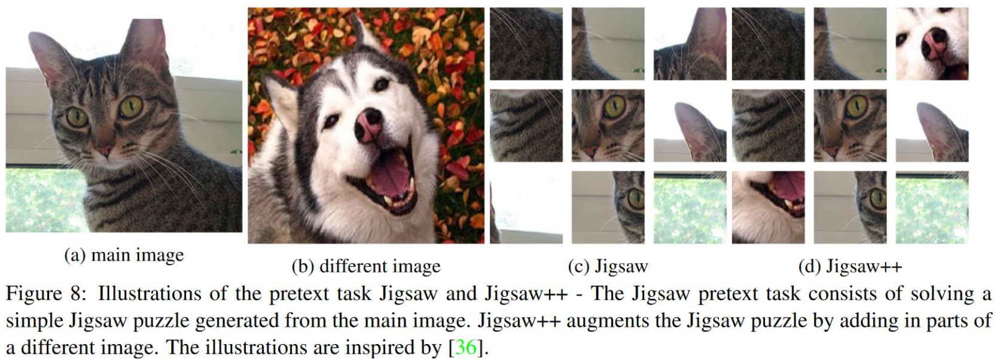

## Damaged jigsaw

Main idea: remove part from jigsaw and try to restore it + color the picture.

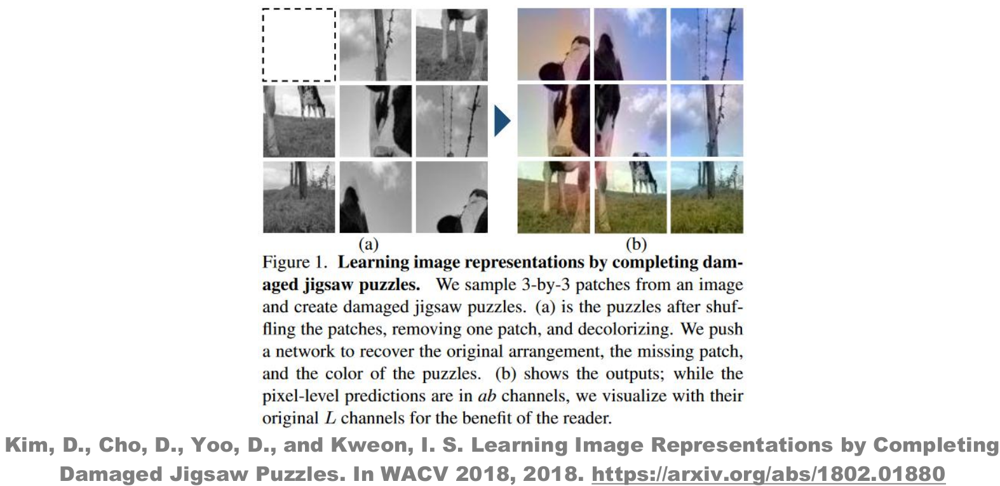

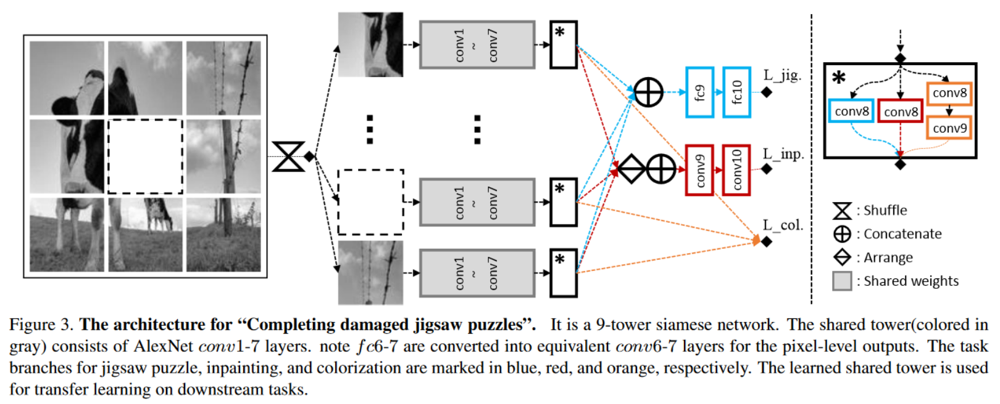

# Image colorization

Each block is 2-3 Dilated Convolutions + ReLu + BN, no pooling.

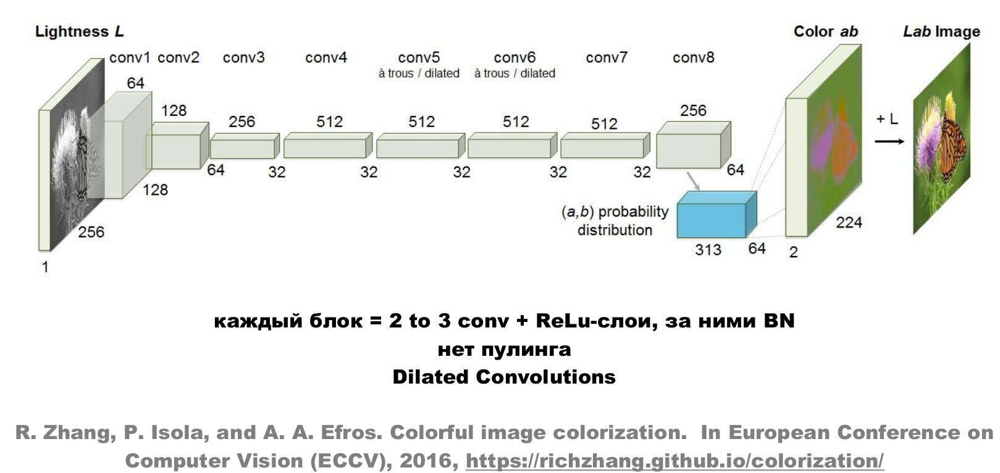

## Image colorization: result

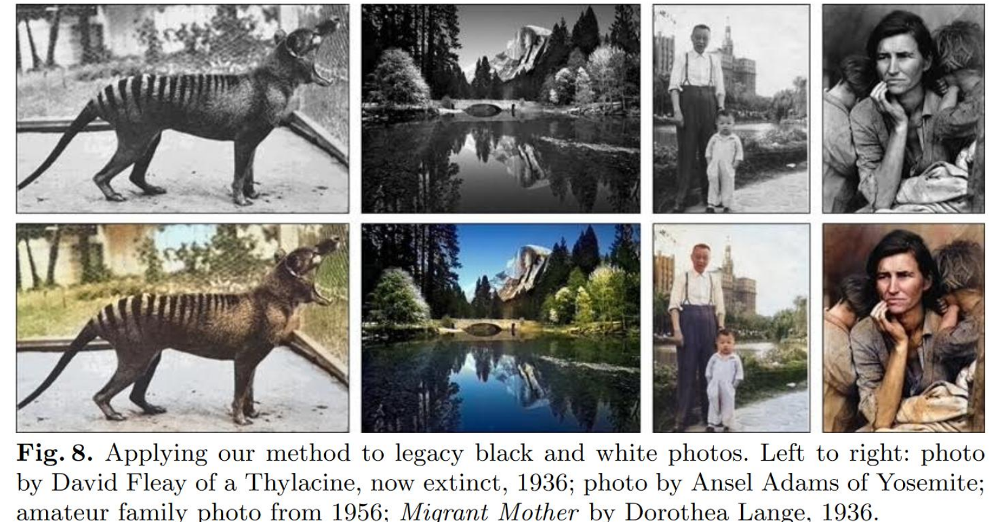

# DeepCluster

Interesting fact: if randomly initialize weights of AlexNet and tune only the last layer - quality on ImageNet will be 12% (fully random initialization - 0.1%) - not bad for 1000 class classification. That means that even with random weights AlexNet can make not bad features representation.

So main idea: clausterize outputs of some layers and use cluster numbers as class labels in classification task. Do it iteratively. Use overlusterizing - number of clusters must be more than number of classes (like 10000 clusters vs 1000 classes for ImageNet).

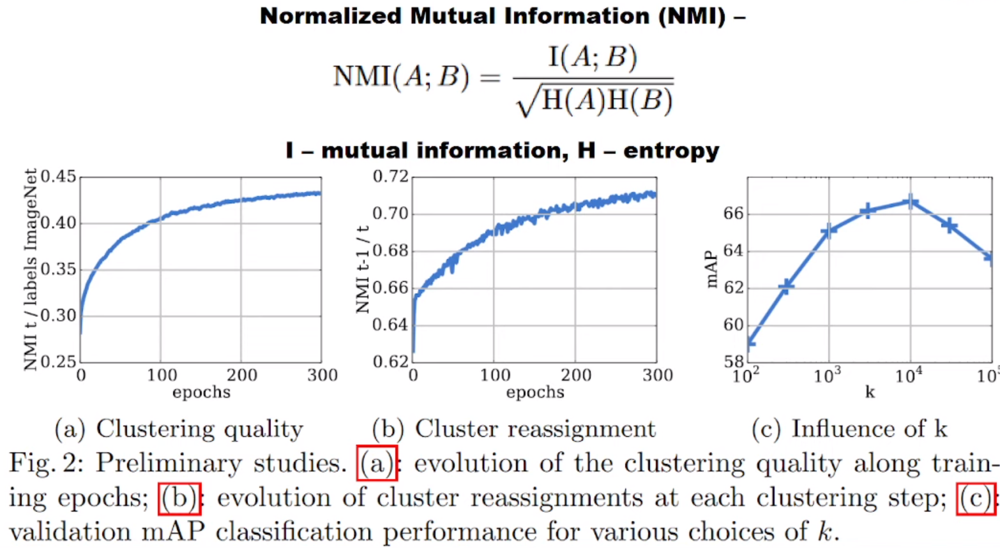

# Motion segmentation prediction

Main idea: pixels that are moving together are probably part of one object. So let's get markup from video and learn to restore it from one frame

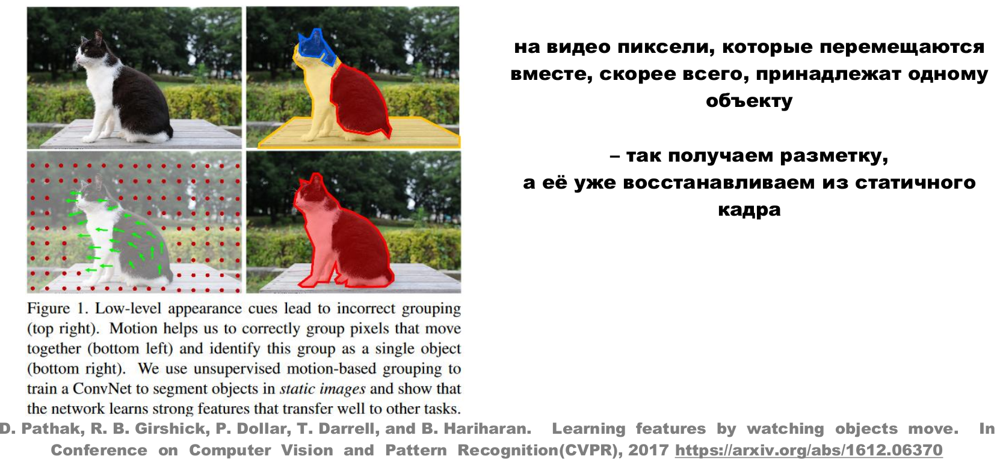

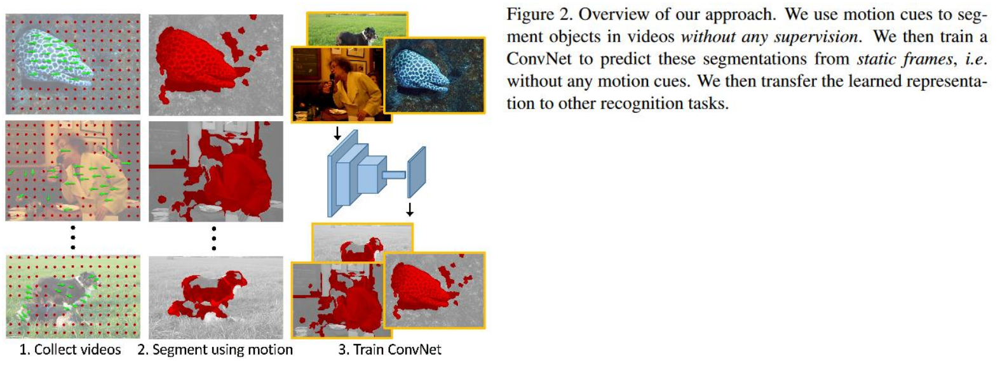

# Ambient sounds

Main idea: use CNN to predict sound statistics (averaged for couple of seconds because sound not always corresponds to video) by video frames:
- mean and standard deviation
- Pearson correlation between pairs of channels
- the mean squared response of each of a bank of modulation applied to each channel

Also there is a clustered format (k-means). Or PCA + binarization of main components => way to obtain labels for learning.

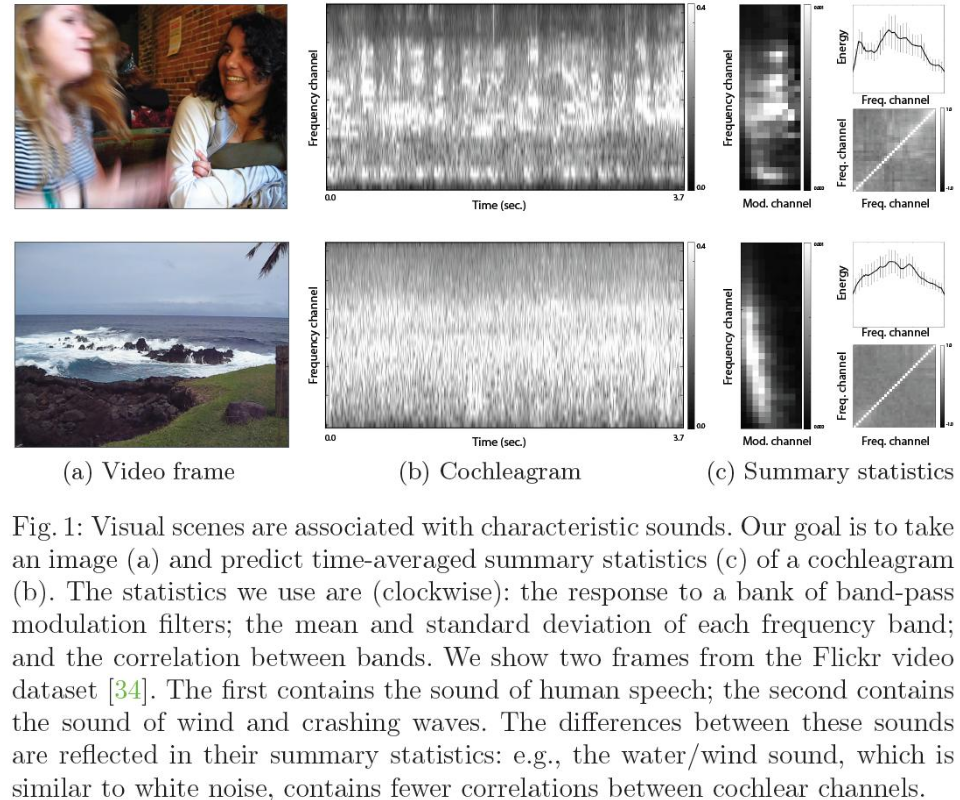

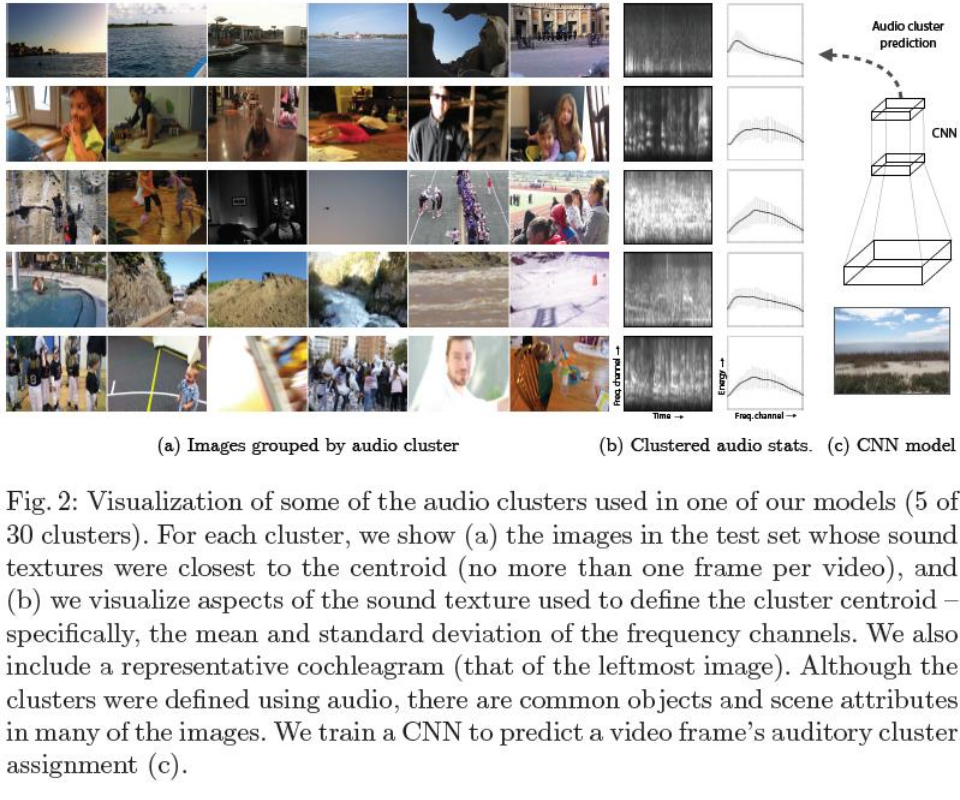

# Counting of visual primitives

Main idea: 
- split image by chunks and count number of primitives for each chunk 
- different chunk more likely has different number of primitives
- image transformation (e.g. scale, rotate, noising, etc.) more likely doesn't change the number of primitives
- this task is solved as regression task (what exactly primitives are counted - we don't know)

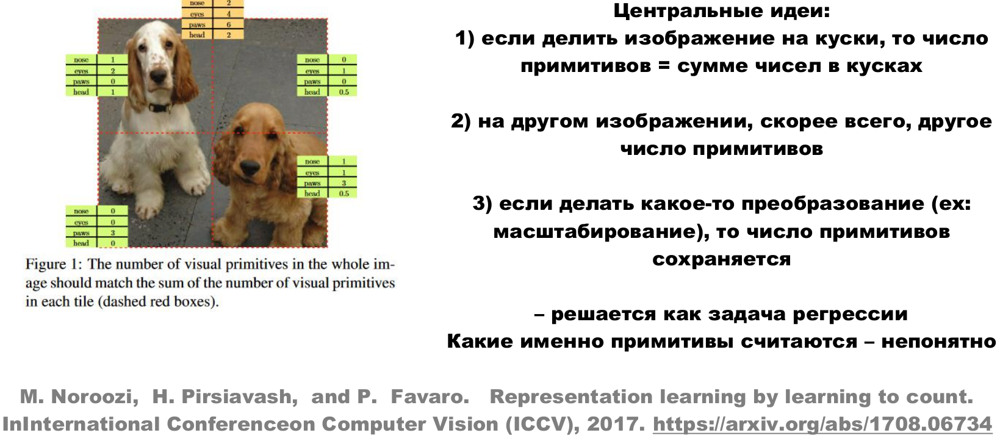

So we take full image, same image but splitted by chanks and some random image. Then pass all that images and chunks through NN and require the sum of representation vectors of image chunks to be equal to vector of full image. Also we require the representation vector of full image to be as dissimilar as possible to representation vector of random image.

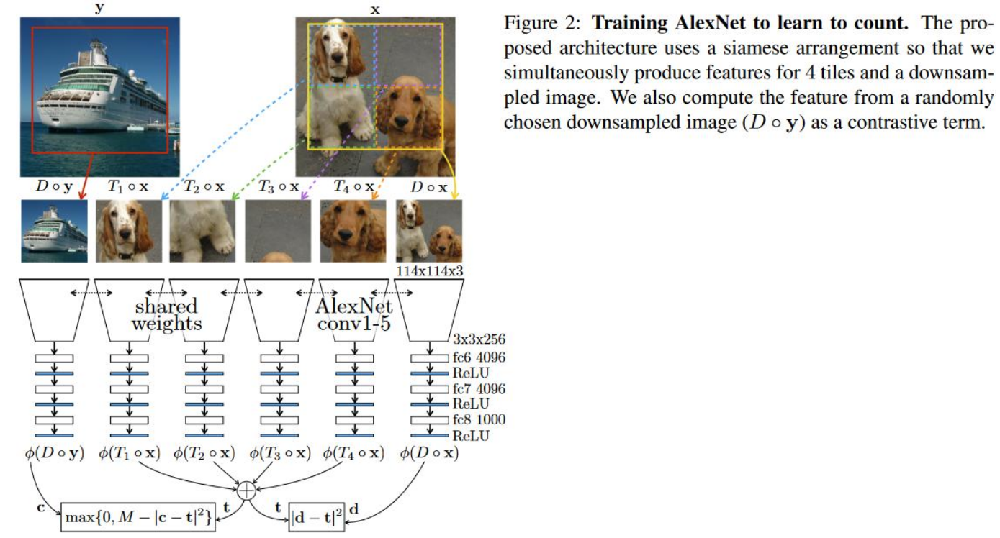

## Counting: result

Good for classification but not so good in detection and segmentation.

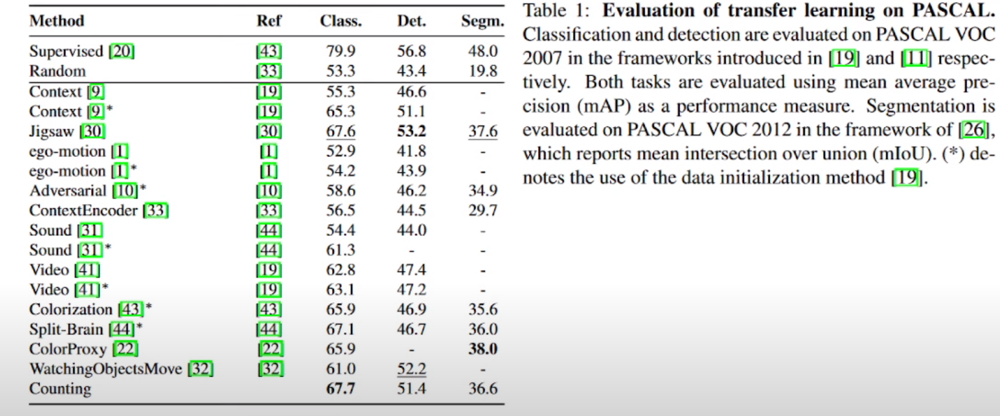

# Multi-task Self-Supervised Visual Learning

Main idea:
- learn 4 tasks simultaneously - relative position + colorization + exemplar + motion segmentation 
- self-pretrain NN
- freeze weights
- L1-loss

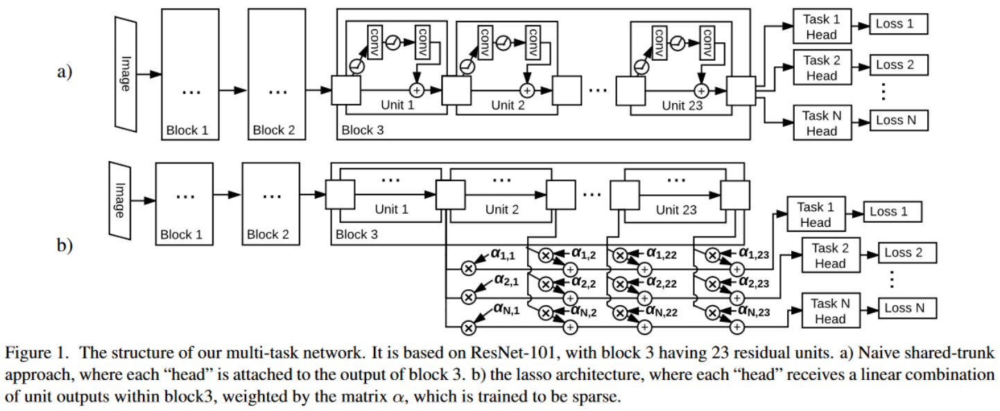

## Multi-task Self-Supervised Visual Learning: result

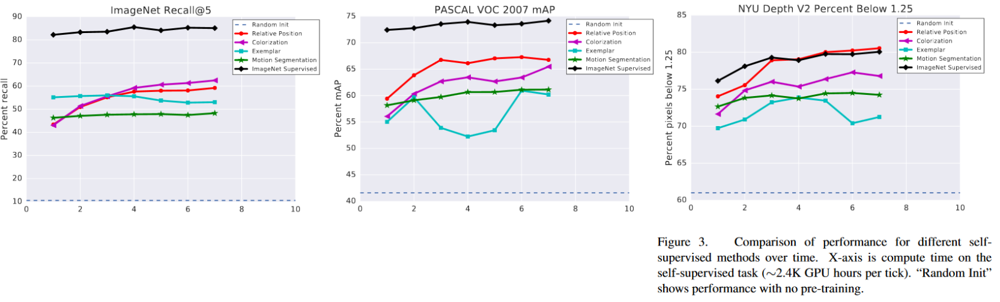

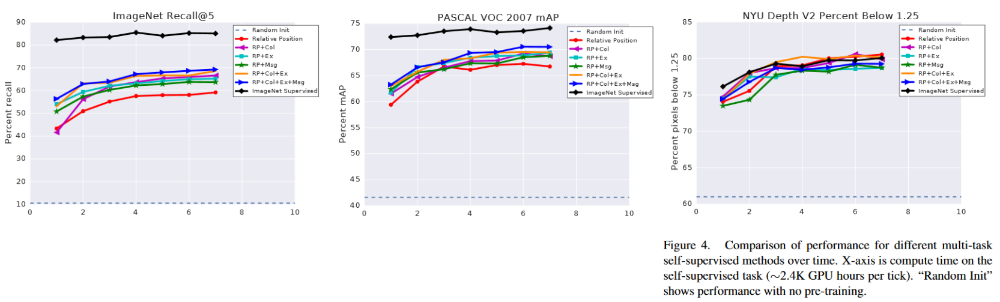

# Temporal coherence of color

Main idea: model takes many input grey-colored frames and also one colored and one grey-colored reference frames. It's trained to restore colors for input frames buy using colored and grey-colored reference frames.

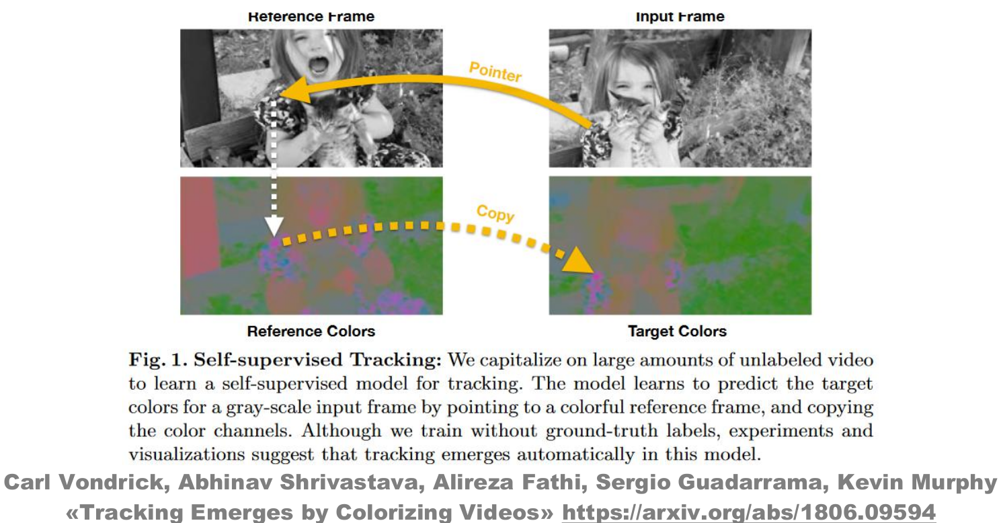

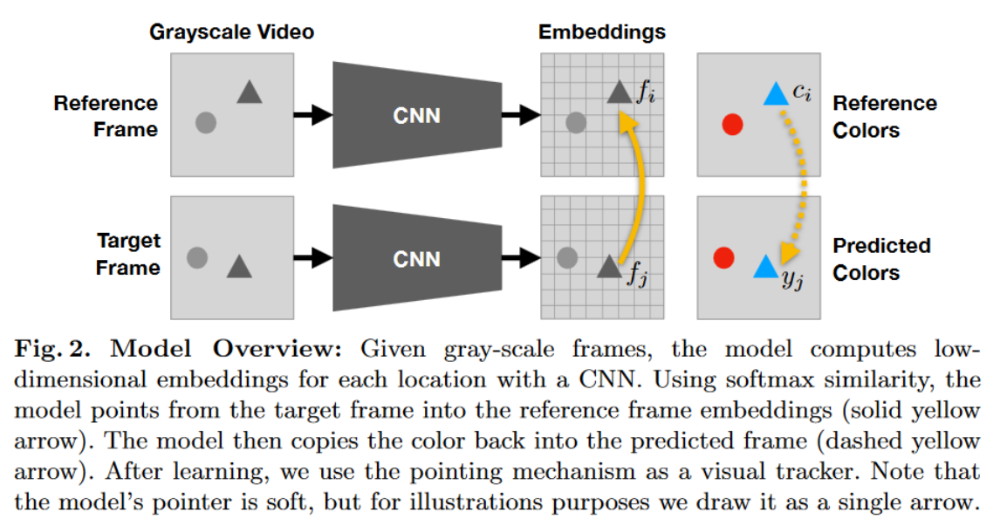

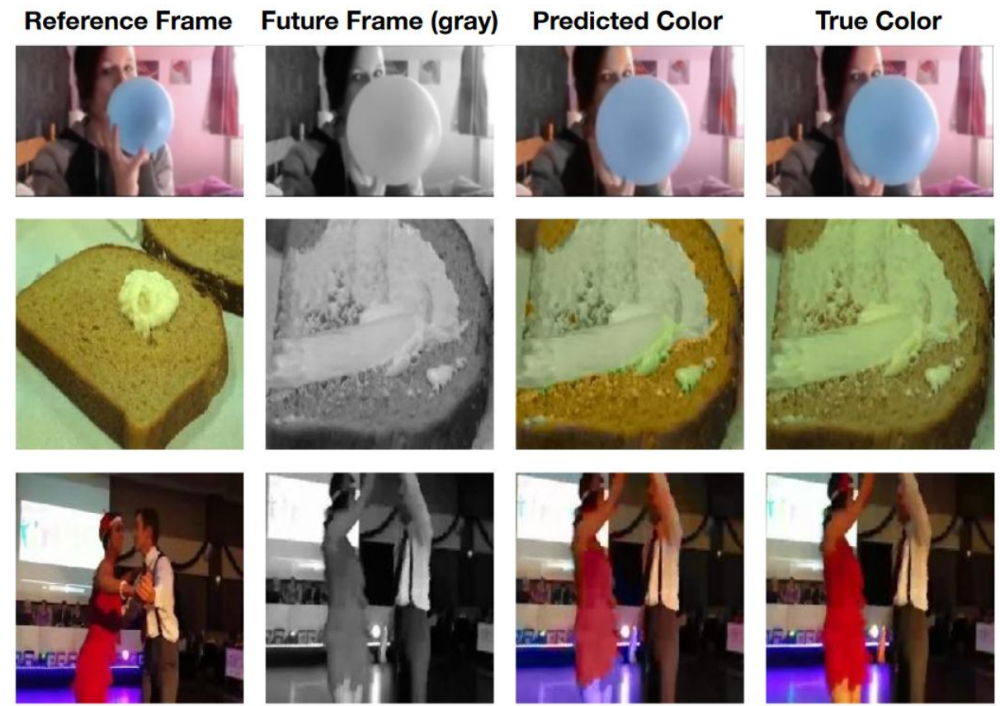

Temporal coherence of color can be used for video segmentation

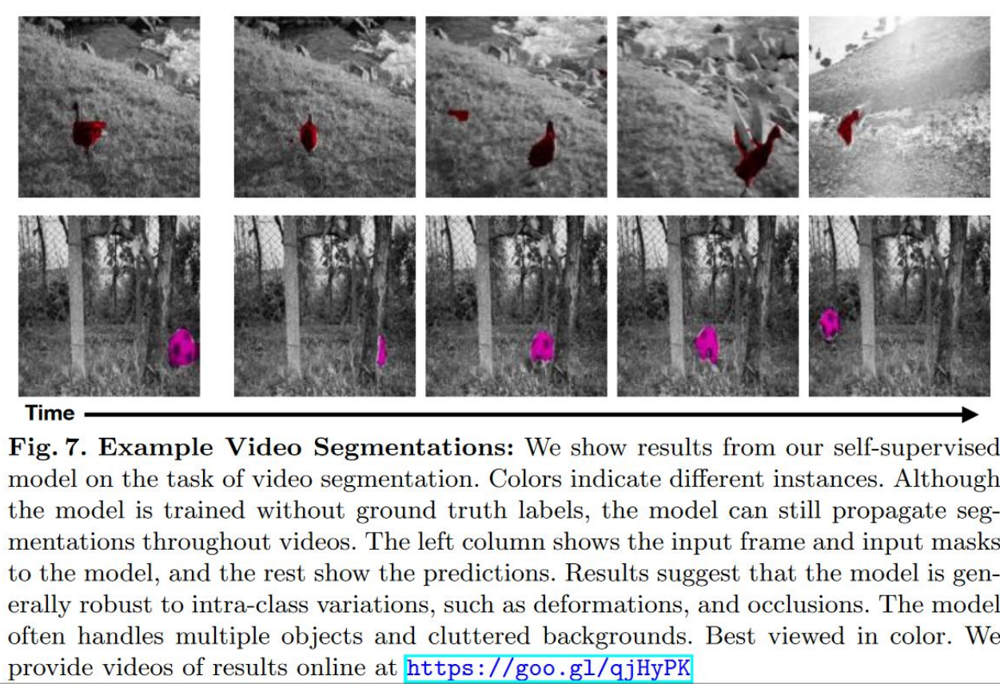

# Temporal Context-based Learning

Main idea: learn to place video frames in correct order

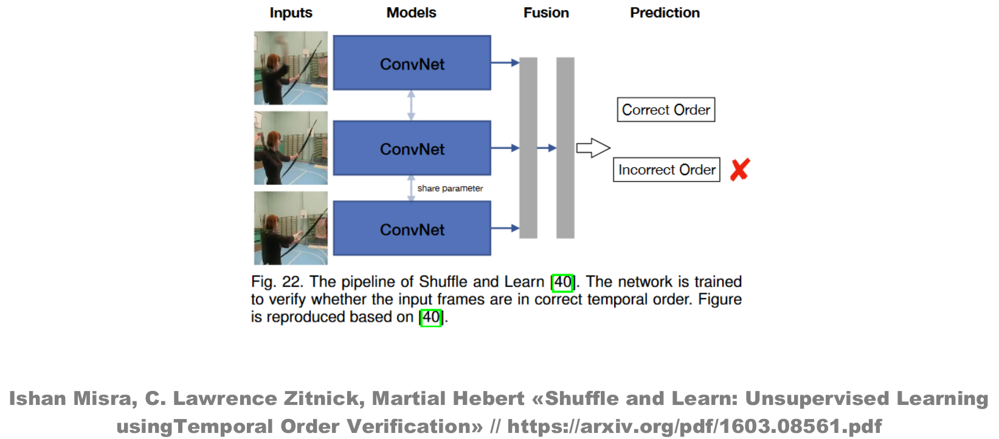

# Learning from Visual-Audio Correspondence

Main idea make a model that consists of two Base-CNN + Top-CNN to learn transformation between two similar images/soundtracks: what transformation should be performed to transform one image to another. Then take one pre-trained Base-CNN and use it in different tasks.

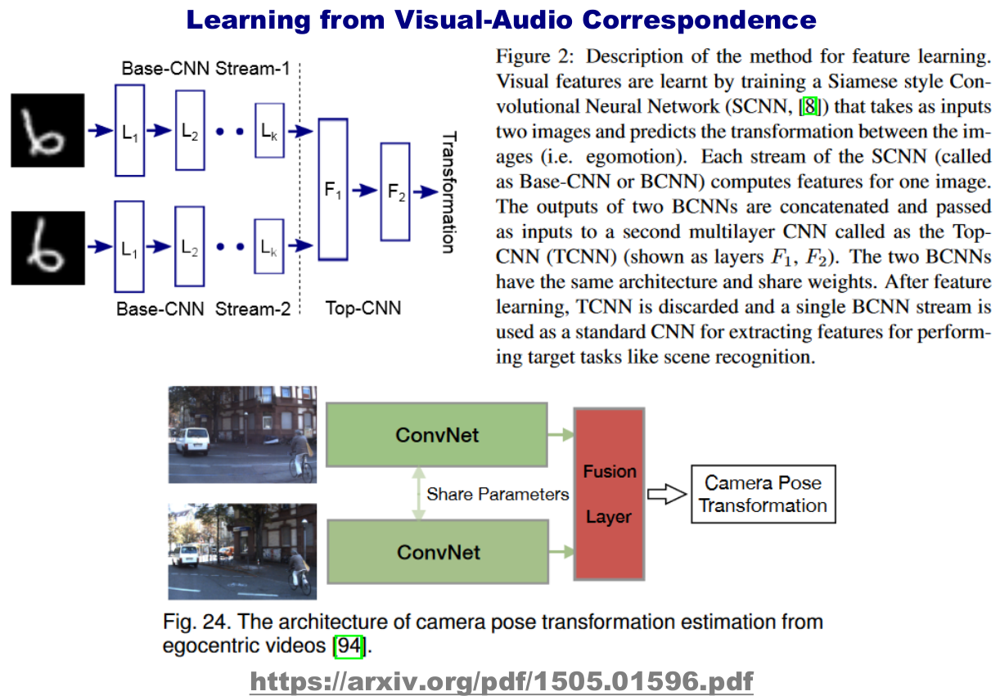

# Autoencoders (Context-Encoder)

Main idea: restore dropped rectangular image region (something like BERT but for image)

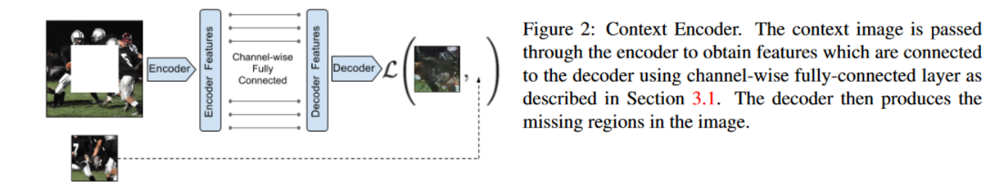

## Autoencoders: architechture

Encoder => 4000-vector => Decoder => L2-loss + Adversarial Discriminator (assesses how much output resembles original image)

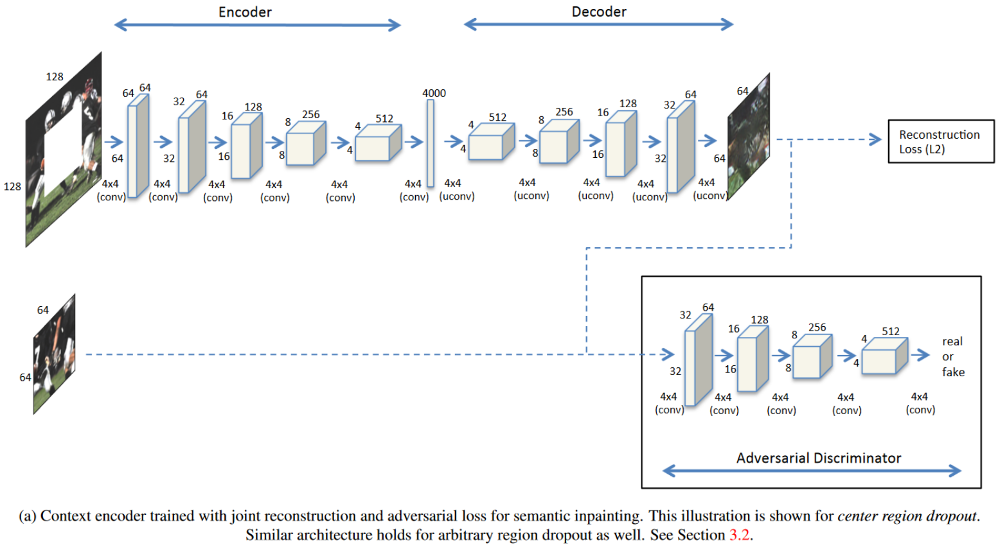

## Autoencoders: image inpainting

Learns to restore dropped region of arbitrary form. Channel-wise FC-layer is used as attention analog (it wasn't created yet when Auto-Encoder were released)

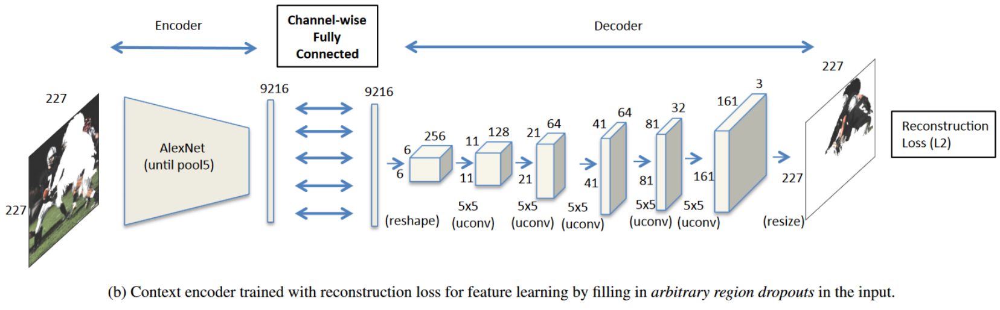

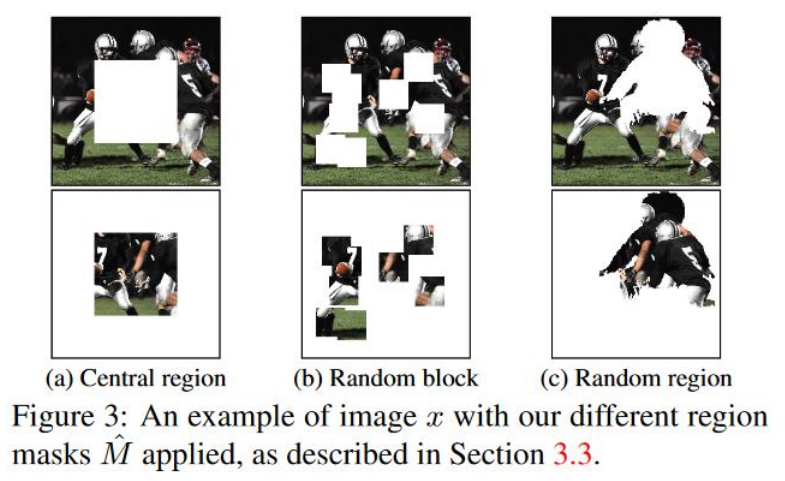

## Autoencoders: result

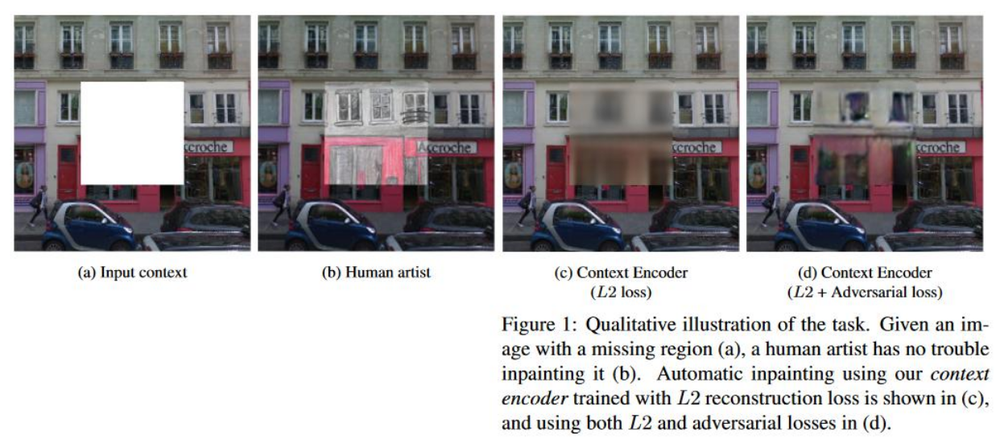

# Split-brain Autoencoders

Main idea: split channels on 2 groups. Two NNs learn to predict one group by another.

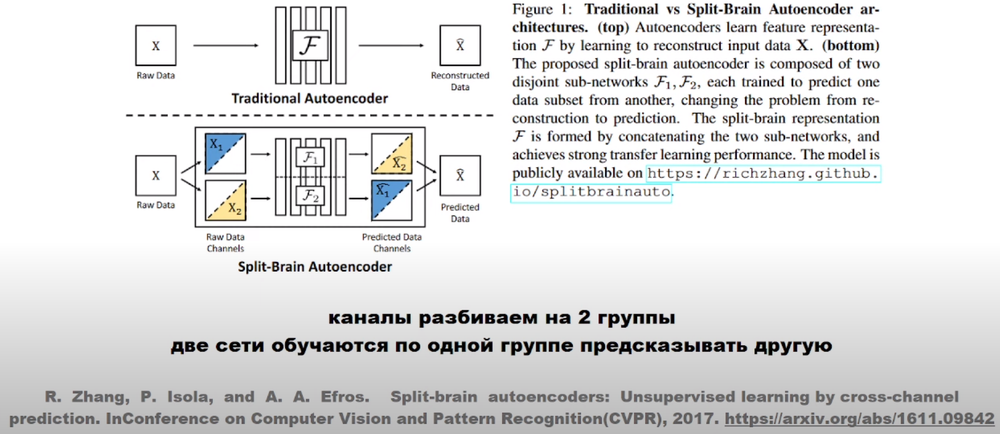

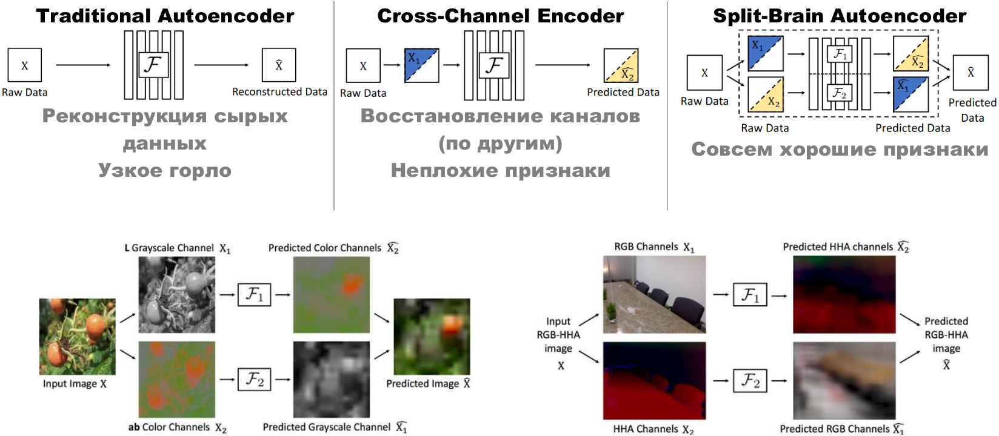

# Modern approach

There are two types of modern approach: Contrastive SSL and Generative SSL.

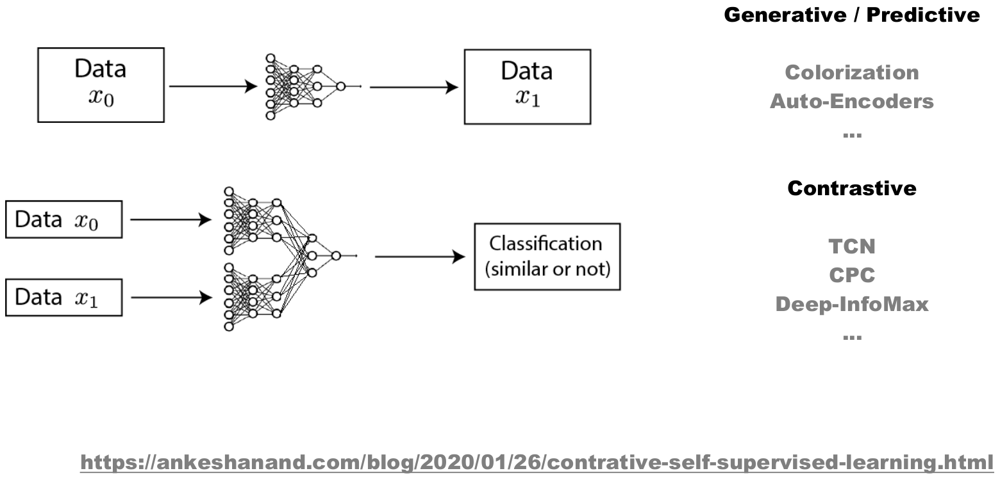

# Modern approach: Contrastive SSL

For point *x*, positive example *x<sup>+</sup>*, negative example *x<sup>-</sup>*, encoder *f* and similarity *score* we want: 

*score( x, x<sup>+</sup>) >> score( x, x<sup>-</sup>)*, where *score( x, x<sup>+</sup>) = f(x)<sup>T</sup> f(x<sup>+</sup>)*

Also augmentations x -> T(x) are often added.

Try to optimize for one positive example and N-1 negative examples loss:

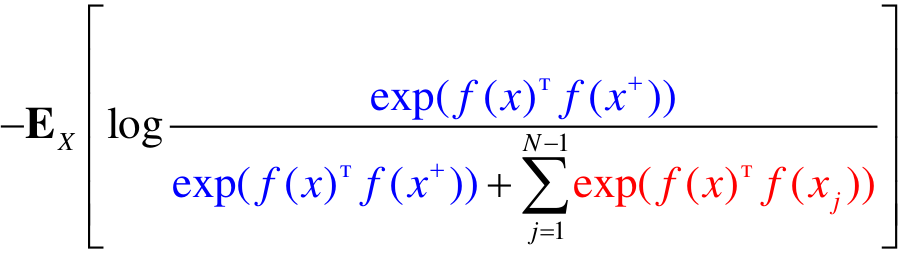

This loss is called InfoNCE loss / multi-class n-pair loss / ranking-based NCE

More info here: https://arxiv.org/abs/1905.06922

## Supervisesd Contrastive Learning

At first double NN with InfoNCE loss is trained, than add fine-tune with original labels and CE-loss. This approach is better than classic supervised approach.

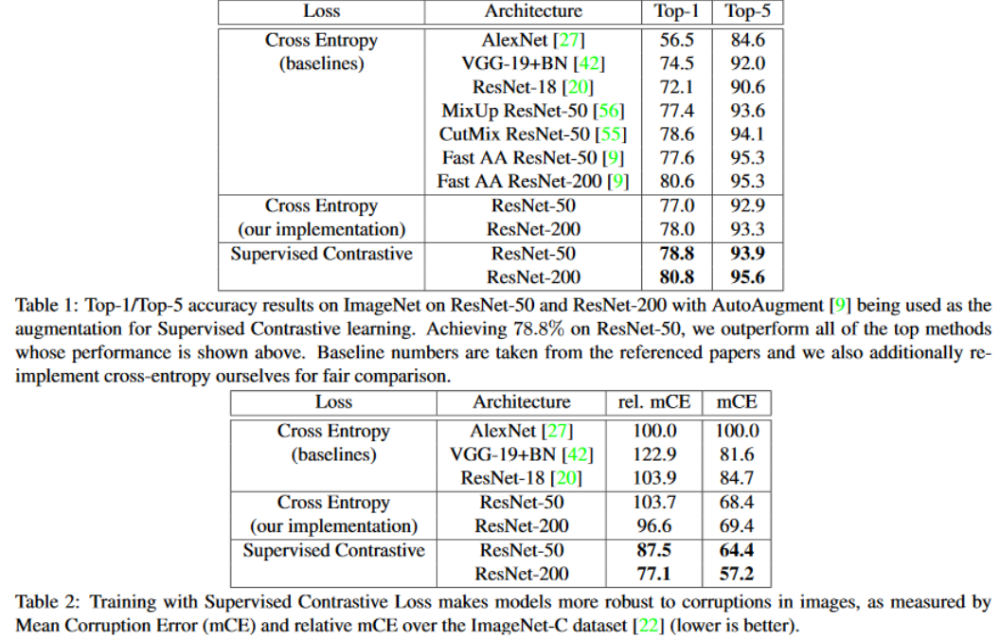

More info here https://arxiv.org/pdf/2004.11362.pdf

# Invariant Information Clustering (IIC)

Main idea: 
- maximize mutual information (MI) between different augmentations of image
- model makes soft clusterization
- Sobel filtering

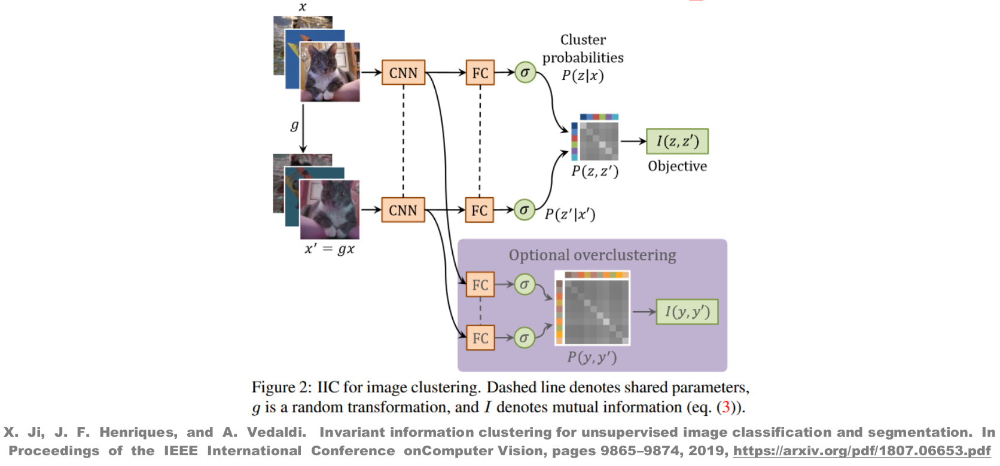

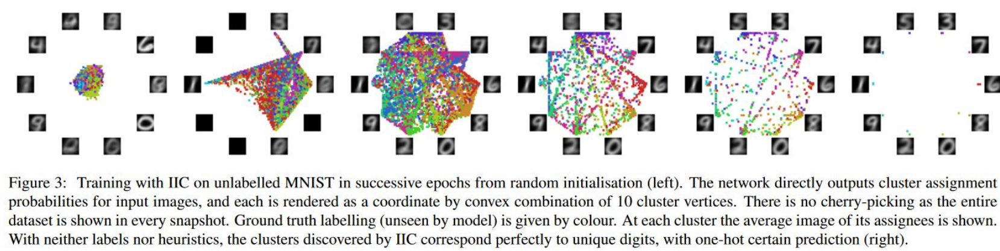

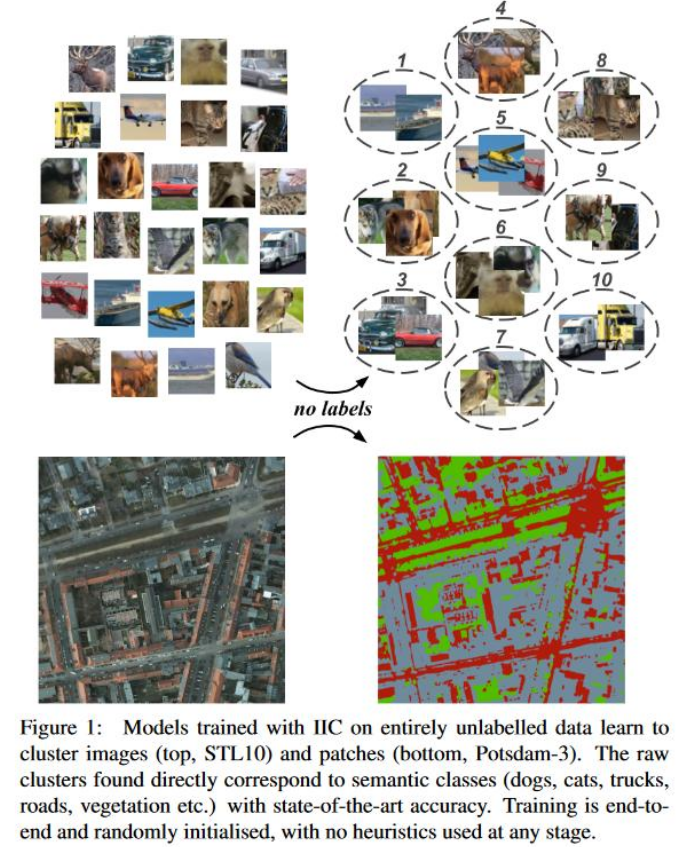

# Deep InfoMax (DIM)

Main idea: maximize MI between image patches and encoder output.

But we can't do it straightly: too many irrelevant fragments.

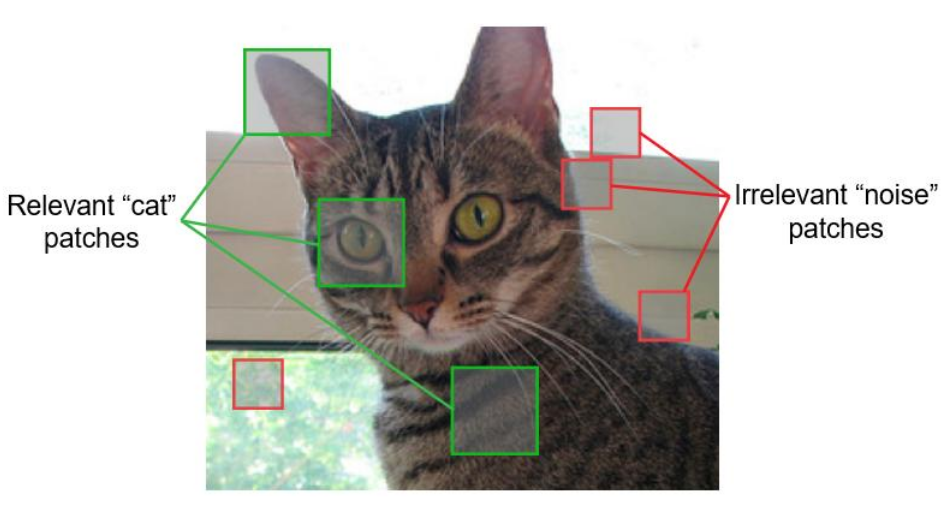

So let's create M x M feature vectors from M x M input patches and summarize them into a single feature vector Y. Then we pass this vector Y and lower level M x M feature map (see Fig. 1) through a discriminator to get the score. Fake samples are drawn by combining the same feature vector Y with a M x M feature map from another image.

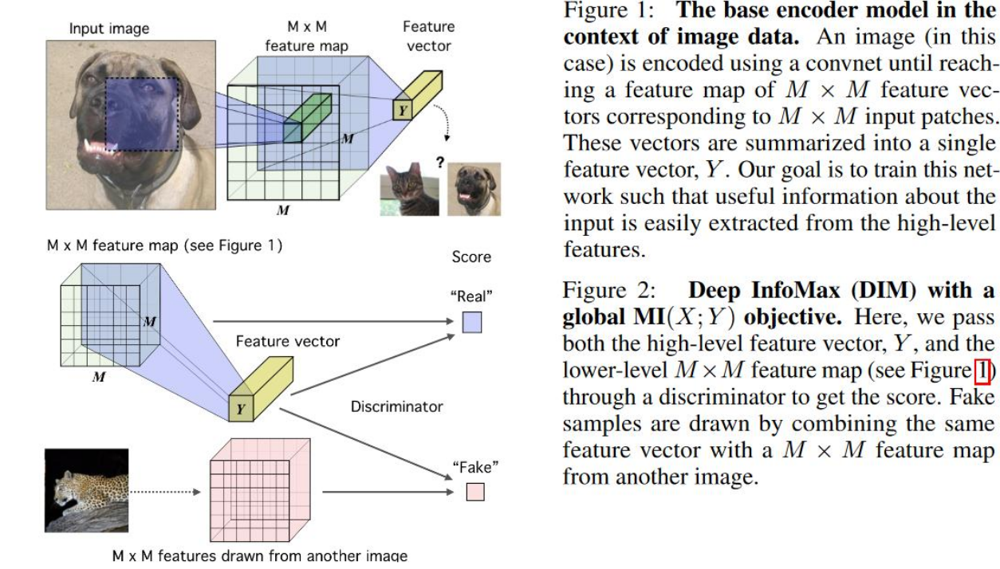

Final solution: concatenate global feature vector Y and lower-level feature at every localion and sent result to discriminator.

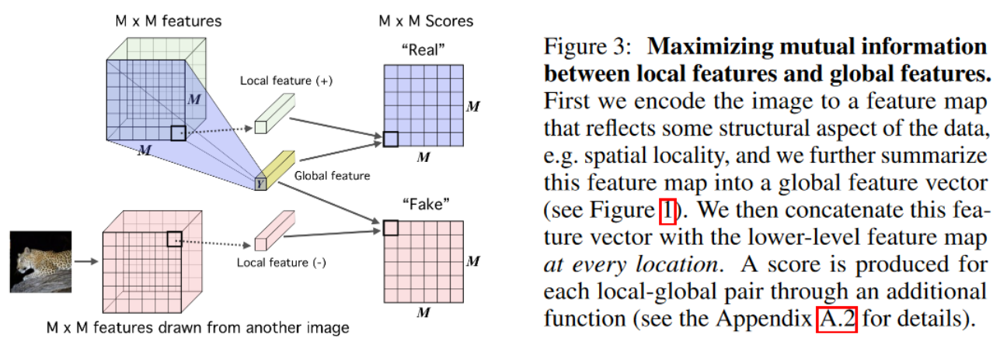

## DIM: result

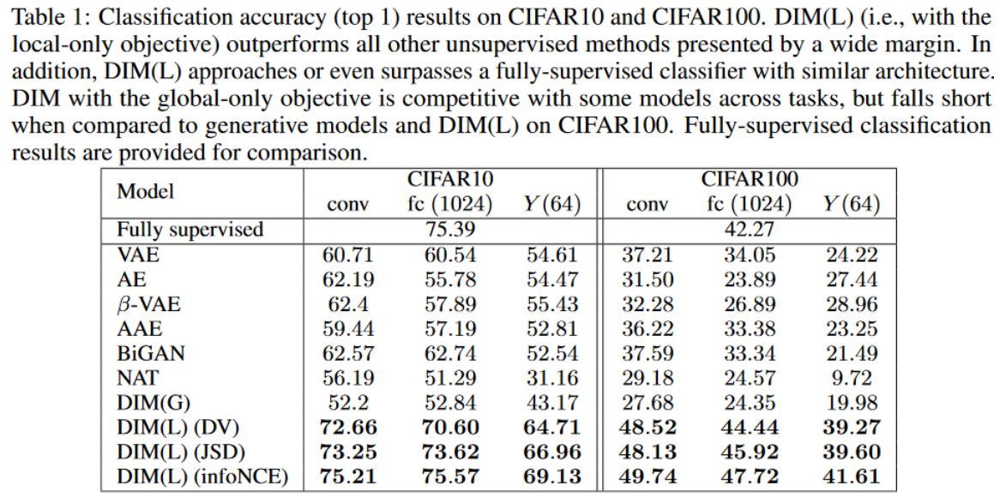